## Loading needed libraries

In [2]:
import glob
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import pickle
from tqdm import tqdm
import pandas as pd
from keras.preprocessing import sequence
from keras.models import Sequential
from keras.layers import LSTM, Embedding, TimeDistributed, Dense, RepeatVector, Merge, Activation, Flatten
from keras.optimizers import Adam, RMSprop
from keras.layers.wrappers import Bidirectional
from keras.applications.inception_v3 import InceptionV3
from keras.preprocessing import image
import nltk

Using TensorFlow backend.


### Making dictionary 
The key is image ID and value is the five captions

In [3]:
token = '/Users/shreyajain/Downloads/Flickr8k_text/Flickr8k.token.txt'
captions = open(token, 'r').read().strip().split('\n')
d = {}
for i, row in enumerate(captions):
    row = row.split('\t')
    row[0] = row[0][:len(row[0])-2]
    if row[0] in d:
        d[row[0]].append(row[1])
    else:
        d[row[0]] = [row[1]]

Example 

In [4]:
d['1000268201_693b08cb0e.jpg']

['A child in a pink dress is climbing up a set of stairs in an entry way .',
 'A girl going into a wooden building .',
 'A little girl climbing into a wooden playhouse .',
 'A little girl climbing the stairs to her playhouse .',
 'A little girl in a pink dress going into a wooden cabin .']


#### img is basically a list of all images

In [5]:
images = '/Users/shreyajain/Downloads/Flicker8k_Dataset/'
img = glob.glob(images+'*.jpg')

In [6]:
img[:5]

['/Users/shreyajain/Downloads/Flicker8k_Dataset/2387197355_237f6f41ee.jpg',
 '/Users/shreyajain/Downloads/Flicker8k_Dataset/2609847254_0ec40c1cce.jpg',
 '/Users/shreyajain/Downloads/Flicker8k_Dataset/2046222127_a6f300e202.jpg',
 '/Users/shreyajain/Downloads/Flicker8k_Dataset/2853743795_e90ebc669d.jpg',
 '/Users/shreyajain/Downloads/Flicker8k_Dataset/2696951725_e0ae54f6da.jpg']

#### Storing image names in train_images, val_images and test_images (given splits)

In [7]:
train_images_file = '/Users/shreyajain/Downloads/Flickr8k_text/Flickr_8k.trainImages.txt'
train_images = set(open(train_images_file, 'r').read().strip().split('\n'))

In [8]:
def split_data(l):
    temp = []
    for i in img:
        if i[len(images):] in l:
            temp.append(i)
    return temp

# Getting the training images from all the images# Gettin 
train_img = split_data(train_images)
len(train_img)

6000

In [9]:
val_images_file = '/Users/shreyajain/Downloads/Flickr8k_text/Flickr_8k.devImages.txt'
val_images = set(open(val_images_file, 'r').read().strip().split('\n'))
# Getting the validation images from all the images
val_img = split_data(val_images)
len(val_img)

1000

In [10]:
test_images_file = '/Users/shreyajain/Downloads/Flickr8k_text/Flickr_8k.testImages.txt'
test_images = set(open(test_images_file, 'r').read().strip().split('\n'))

# Getting the testing images from all the images# Gettin 
test_img = split_data(test_images)
len(test_img)

1000

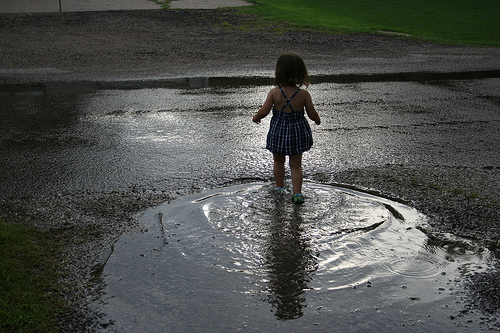

In [11]:
Image.open(train_img[11])


In [12]:
def preprocess_input(x):
    x /= 255.
    return x

In [13]:
def preprocess(image_path):
    img = image.load_img(image_path, target_size=(299, 299))
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)
    return x

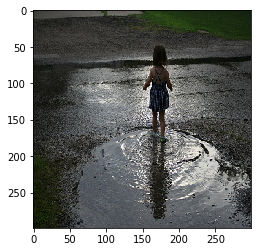

In [14]:
plt.imshow(np.squeeze(preprocess(train_img[11])))

### Load pre made Inception Model

In [15]:
model = InceptionV3(weights='imagenet')

## Remove last layer which gives softmax as we need features not the classification

In [16]:
from keras.models import Model

new_input = model.input
hidden_layer = model.layers[-2].output

model_new = Model(new_input, hidden_layer)

In [17]:
tryi = model_new.predict(preprocess(train_img[11]))
tryi

array([[ 0.14695667,  0.07355815,  0.07267117, ...,  0.20208935,
         0.44788441,  0.19494531]], dtype=float32)

### We need to pass our images through this trained model to get the features

In [18]:
def encode(image):
    image = preprocess(image)
    temp_enc = model_new.predict(image)
    temp_enc = np.reshape(temp_enc, temp_enc.shape[1])
    return temp_enc

In [19]:
# encoding_train = {}
# for img in tqdm(train_img):
#     encoding_train[img[len(images):]] = encode(img)

In [20]:
# with open("encoded_images_inceptionV3.p", "wb") as encoded_pickle:
#     pickle.dump(encoding_train, encoded_pickle)

### Storing results so that no need to do this over and over

In [21]:
encoding_train = pickle.load(open('encoded_images_inceptionV3.p', 'rb'))

In [22]:
# encoding_test = {}
# for img in tqdm(test_img):
#     encoding_test[img[len(images):]] = encode(img)

In [23]:
# with open("encoded_images_test_inceptionV3.p", "wb") as encoded_pickle:
#     pickle.dump(encoding_test, encoded_pickle)

In [24]:
encoding_test = pickle.load(open('encoded_images_test_inceptionV3.p', 'rb'))

In [25]:
train_d = {}
for i in train_img:
    if i[len(images):] in d:
        train_d[i] = d[i[len(images):]]


In [26]:
val_d = {}
for i in val_img:
    if i[len(images):] in d:
        val_d[i] = d[i[len(images):]]
test_d = {}
for i in test_img:
    if i[len(images):] in d:
        test_d[i] = d[i[len(images):]]

In [27]:
caps = []
for key, val in train_d.items():
    for i in val:
        caps.append('<start> ' + i + ' <end>')

In [28]:
words = [i.split() for i in caps]
unique = []
for i in words:
    unique.extend(i)
unique = list(set(unique))
with open("unique.p", "wb") as pickle_d:
    pickle.dump(unique, pickle_d)
unique = pickle.load(open('unique.p', 'rb'))

In [29]:
word2idx = {val:index for index, val in enumerate(unique)}
idx2word = {index:val for index, val in enumerate(unique)}
print(word2idx['<start>'])
print(idx2word[4022])

4022
<start>


In [30]:
max_len = 0
for c in caps:
    c = c.split()
    if len(c) > max_len:
        max_len = len(c)
print(max_len)

40


In [31]:
vocab_size = len(unique)
f = open('/Users/shreyajain/Downloads/flickr8k_training_dataset.txt', 'w')
f.write("image_id\tcaptions\n")

In [32]:
for key, val in train_d.items():
    for i in val:
        f.write(key[len(images):] + "\t" + "<start> " + i +" <end>" + "\n")

f.close()

In [33]:
df = pd.read_csv('/Users/shreyajain/Downloads/flickr8k_training_dataset.txt', delimiter='\t')

In [34]:
df

,image_id,captions
0,3070485870_eab1a75c6f.jpg,<start> A snowboarder is in the air after maki...
1,3070485870_eab1a75c6f.jpg,<start> A snowboarder is jumping over a snow s...
2,3070485870_eab1a75c6f.jpg,<start> A snowboarder makes a jump against a w...
3,3070485870_eab1a75c6f.jpg,<start> A snowboarder performs a jump in the s...
4,3070485870_eab1a75c6f.jpg,<start> Snowboarder does stunt on his board in...
5,2975253472_0f0c2dea70.jpg,<start> A soccer player in red runs in front o...
6,2975253472_0f0c2dea70.jpg,<start> Men play in a soccer game . <end>
7,2975253472_0f0c2dea70.jpg,"<start> One man in a red shirt is falling , wh..."
8,2975253472_0f0c2dea70.jpg,<start> Two men are playing soccer on a grassy...
9,2975253472_0f0c2dea70.jpg,"<start> Two men playing a game , running on a ..."


In [35]:
c = [i for i in df['captions']]
imgs = [i for i in df['image_id']]

In [36]:
a = c[-1]
a, imgs[-1]
for i in a.split():
    print (i, "=>", word2idx[i])

('<start>', '=>', 4022)
('The', '=>', 3356)
('boy', '=>', 4658)
('under', '=>', 6218)
('the', '=>', 2444)
('tree', '=>', 202)
('holding', '=>', 2554)
('a', '=>', 3208)
('rope', '=>', 3451)
('.', '=>', 324)
('<end>', '=>', 8056)


### custom generator

In [37]:
def data_generator(batch_size):
        partial_caps = []
        next_words = []
        images = []
        
        df = pd.read_csv('/Users/shreyajain/Downloads/flickr8k_training_dataset.txt', delimiter='\t')
        df = df.sample(frac=1)
        iter = df.iterrows()
        c = []
        imgs = []
        for i in range(df.shape[0]):
            x = next(iter)
            c.append(x[1][1])
            imgs.append(x[1][0])


        count = 0
        while True:
            for j, text in enumerate(c):
                current_image = encoding_train[imgs[j]]
                for i in range(len(text.split())-1):
                    count+=1
                    
                    partial = [word2idx[txt] for txt in text.split()[:i+1]]
                    partial_caps.append(partial)
                    
                    # Initializing with zeros to create a one-hot encoding matrix
                    # This is what we have to predict
                    # Hence initializing it with vocab_size length
                    n = np.zeros(vocab_size)
                    # Setting the next word to 1 in the one-hot encoded matrix
                    n[word2idx[text.split()[i+1]]] = 1
                    next_words.append(n)
                    
                    images.append(current_image)

                    if count>=batch_size:
                        next_words = np.asarray(next_words)
                        images = np.asarray(images)
                        partial_caps = sequence.pad_sequences(partial_caps, maxlen=max_len, padding='post')
                        yield [[images, partial_caps], next_words]
                        partial_caps = []
                        next_words = []
                        images = []
                        count = 0

## Model for captioning

In [38]:
from keras.layers import *
EMBEDDING_DIM=300

input1 = Input(shape=(2048,))
image= Dense(EMBEDDING_DIM, activation='relu')(input1)
img = RepeatVector(max_len)(image)
input2 = Input(shape=(max_len,))
emb = Embedding(vocab_size, 300, input_length=max_len)(input2)
lang= LSTM(256,return_sequences=True)(emb)
lang= TimeDistributed(Dense(EMBEDDING_DIM))(lang)
x = Concatenate()([img,lang])
x = Bidirectional(LSTM(256, return_sequences=False))(x)
x = Dense(vocab_size)(x)
pred = Activation('softmax')(x)
model = Model(inputs=[input1,input2],outputs=pred)
model.compile(loss='categorical_crossentropy', optimizer='RMSprop', metrics=['accuracy'])

model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            (None, 40)           0                                            
__________________________________________________________________________________________________
input_2 (InputLayer)            (None, 2048)         0                                            
__________________________________________________________________________________________________
embedding_1 (Embedding)         (None, 40, 300)      2476800     input_3[0][0]                    
__________________________________________________________________________________________________
dense_1 (Dense)                 (None, 300)          614700      input_2[0][0]                    
__________________________________________________________________________________________________
lstm_1 (LS

In [ ]:
model.fit_generator(data_generator(batch_size=1024), steps_per_epoch=30000/1024,epochs=30, verbose=1)


In [46]:
model.fit_generator(data_generator(batch_size=2048), steps_per_epoch=30000/2048,epochs=20, verbose=1)


Epoch 1/20
14/14 [==============================] - 252s 18s/step - loss: 2.7861 - acc: 0.4320
Epoch 2/20
14/14 [==============================] - 267s 19s/step - loss: 2.8117 - acc: 0.4265
Epoch 3/20
14/14 [==============================] - 268s 19s/step - loss: 2.7629 - acc: 0.4328
Epoch 4/20
14/14 [==============================] - 264s 19s/step - loss: 2.8399 - acc: 0.4246
Epoch 5/20
14/14 [==============================] - 270s 19s/step - loss: 2.7938 - acc: 0.4309
Epoch 6/20
14/14 [==============================] - 268s 19s/step - loss: 2.7909 - acc: 0.4275
Epoch 7/20
14/14 [==============================] - 268s 19s/step - loss: 2.8105 - acc: 0.4276
Epoch 8/20
14/14 [==============================] - 269s 19s/step - loss: 2.7777 - acc: 0.4320
Epoch 9/20
14/14 [==============================] - 284s 20s/step - loss: 2.7992 - acc: 0.4304
Epoch 10/20
14/14 [==============================] - 264s 19s/step - loss: 2.8394 - acc: 0.4288
Epoch 11/20
14/14 [==============================

### Save the model

In [47]:
model.save_weights('./captioning.h5')

### Predict captions

In [48]:
def predict_captions(image):
    start_word = ["<start>"]
    while True:
        par_caps = [word2idx[i] for i in start_word]
        par_caps = sequence.pad_sequences([par_caps], maxlen=max_len, padding='post')
        e = encoding_test[image[len(images):]]
        preds = model.predict([np.array([e]), np.array(par_caps)])
        word_pred = idx2word[np.argmax(preds[0])]
        start_word.append(word_pred)
        if word_pred == "<end>" or len(start_word) > max_len:
            break
    return ' '.join(start_word[1:-1])

### Beam Search 

In [49]:
def beam_search_predictions(image, beam_index = 3):
    start = [word2idx["<start>"]]
    
    start_word = [[start, 0.0]]
    
    while len(start_word[0][0]) < max_len:
        temp = []
        for s in start_word:
            par_caps = sequence.pad_sequences([s[0]], maxlen=max_len, padding='post')
            e = encoding_test[image[len(images):]]
            preds = model.predict([np.array([e]), np.array(par_caps)])
            
            word_preds = np.argsort(preds[0])[-beam_index:]
            
            # Getting the top <beam_index>(n) predictions and creating a 
            # new list so as to put them via the model again
            for w in word_preds:
                next_cap, prob = s[0][:], s[1]
                next_cap.append(w)
                prob += preds[0][w]
                temp.append([next_cap, prob])
                    
        start_word = temp
        # Sorting according to the probabilities
        start_word = sorted(start_word, reverse=False, key=lambda l: l[1])
        # Getting the top words
        start_word = start_word[-beam_index:]
    
    start_word = start_word[-1][0]
    intermediate_caption = [idx2word[i] for i in start_word]

    final_caption = []
    
    for i in intermediate_caption:
        if i != '<end>':
            final_caption.append(i)
        else:
            break
    
    final_caption = ' '.join(final_caption[1:])
    return final_caption

### Show examples

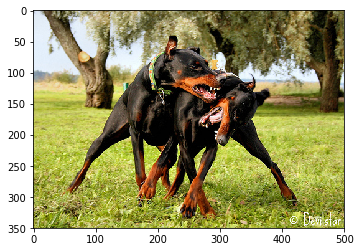

('Normal Max search:', 'Two dogs are running through the grass .')
('Beam Search, k=3:', 'Two dogs are running in the grass .')
('Beam Search, k=5:', 'Two dogs are running in the grass .')
('Beam Search, k=7:', 'Two dogs play in the snow .')


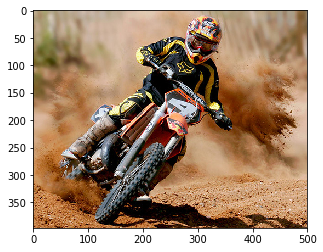

('Normal Max search:', 'A man in a red helmet and helmet is riding a dirt bike .')
('Beam Search, k=3:', 'A man is riding a dirt bike .')
('Beam Search, k=5:', 'A man on a dirt bike .')
('Beam Search, k=7:', 'A man on a dirt bike .')


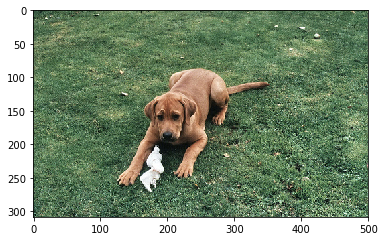

('Normal Max search:', 'A brown dog is playing with a toy .')
('Beam Search, k=3:', 'A brown dog is playing with a toy .')
('Beam Search, k=5:', 'A brown dog is playing with a toy .')
('Beam Search, k=7:', 'A brown dog is playing with a ball .')


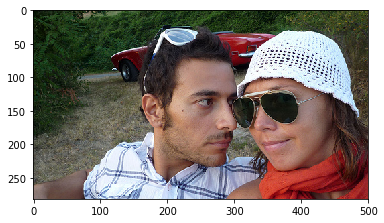

('Normal Max search:', 'A man with a blue hat and sunglasses .')
('Beam Search, k=3:', 'A man and a woman wearing sunglasses .')
('Beam Search, k=5:', 'A man and a woman smiling .')
('Beam Search, k=7:', 'A man and a woman smiling .')


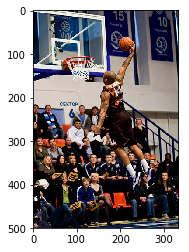

('Normal Max search:', 'A basketball player in a white jersey is being tackled .')
('Beam Search, k=3:', 'A basketball player in a white jersey is trying to block the ball .')
('Beam Search, k=5:', 'A basketball player tries to block the ball .')
('Beam Search, k=7:', 'A basketball player tries to catch the ball .')


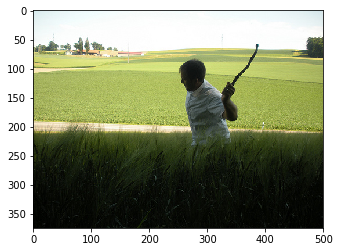

('Normal Max search:', 'A young boy in a red shirt and white shirt is running on a grassy field .')
('Beam Search, k=3:', 'A young boy in a red shirt and blue shirt is running through a grassy field .')
('Beam Search, k=5:', 'A young boy in a red shirt and blue shirt is standing on a grass .')
('Beam Search, k=7:', 'A young boy in a red shirt and a white shirt .')


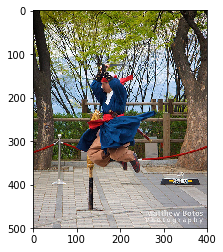

('Normal Max search:', 'A man in a red shirt and a black shirt is riding a skateboard .')
('Beam Search, k=3:', 'A man in a red shirt and a black shirt on a rail .')
('Beam Search, k=5:', 'A man in a red shirt and a black shirt on a rail .')
('Beam Search, k=7:', 'A man on a skateboard .')


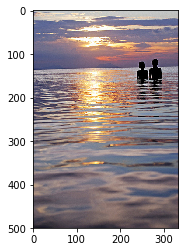

('Normal Max search:', 'A man is standing on a beach .')
('Beam Search, k=3:', 'Two people are standing on the beach .')
('Beam Search, k=5:', 'Two people are standing in the water .')
('Beam Search, k=7:', 'Two people are standing in the water .')


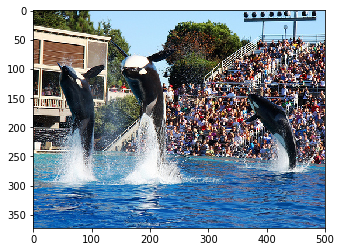

('Normal Max search:', 'A black and black dog is swimming in the water .')
('Beam Search, k=3:', 'A black and black dog is swimming in the water .')
('Beam Search, k=5:', 'A black and black dog is swimming in the water .')
('Beam Search, k=7:', 'A black and black dog is swimming .')


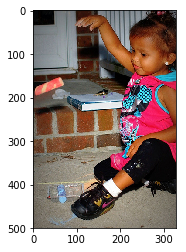

('Normal Max search:', 'A boy in a blue shirt and blue shorts is playing a guitar .')
('Beam Search, k=3:', 'A little boy in a blue shirt is playing on a sidewalk .')
('Beam Search, k=5:', 'A little boy wearing a blue shirt is playing a guitar .')
('Beam Search, k=7:', 'A little boy wearing a blue shirt is playing a guitar .')


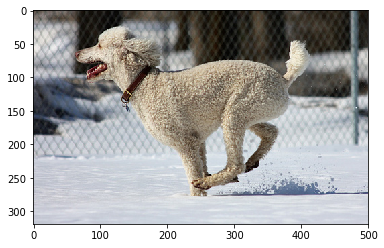

('Normal Max search:', 'A white dog is playing with a white dog .')
('Beam Search, k=3:', 'A white dog plays with a tennis ball .')
('Beam Search, k=5:', 'A white dog plays with a tennis ball .')
('Beam Search, k=7:', 'A white dog plays with a tennis ball .')


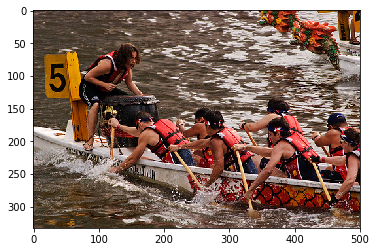

('Normal Max search:', 'A group of people are in a raft .')
('Beam Search, k=3:', 'A group of people on a raft .')
('Beam Search, k=5:', 'A group of people on a raft .')
('Beam Search, k=7:', 'A group of people on a raft .')


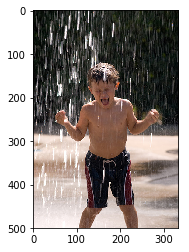

('Normal Max search:', 'A young boy in a pink shirt is running through a puddle .')
('Beam Search, k=3:', 'A young boy in a pink shirt is playing in a puddle .')
('Beam Search, k=5:', 'A young boy in a pink shirt is playing in the water .')
('Beam Search, k=7:', 'A little boy is playing in a puddle .')


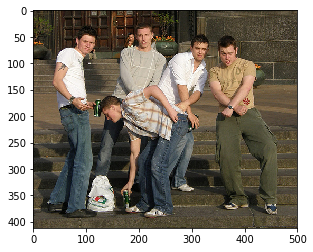

('Normal Max search:', 'A group of people are sitting on a bench .')
('Beam Search, k=3:', 'A group of people are sitting on a bench .')
('Beam Search, k=5:', 'A group of people are sitting on a bench .')
('Beam Search, k=7:', 'A group of people are sitting on a bench .')


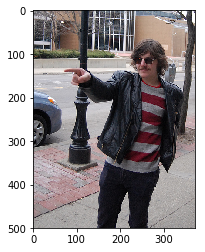

('Normal Max search:', 'A woman in a blue shirt and a blue shirt is walking down a street .')
('Beam Search, k=3:', 'A woman in a blue shirt and a blue shirt stands on a street .')
('Beam Search, k=5:', 'A woman in a blue shirt is walking down a street .')
('Beam Search, k=7:', 'A woman in a blue shirt is walking down the street .')


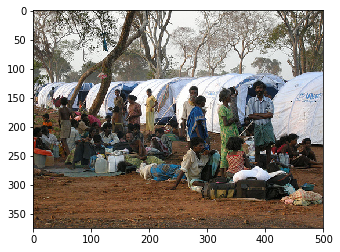

('Normal Max search:', 'A group of people are sitting on a white tent .')
('Beam Search, k=3:', 'A group of people are sitting on a white tent .')
('Beam Search, k=5:', 'A group of people are sitting in front of a tent .')
('Beam Search, k=7:', 'A group of people are sitting in front of a tent .')


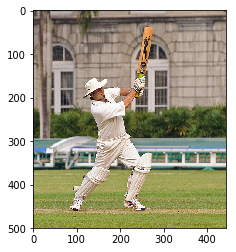

('Normal Max search:', 'A baseball player in a baseball ball .')
('Beam Search, k=3:', 'A baseball player in a baseball ball .')
('Beam Search, k=5:', 'A baseball player in an orange and white and white shirt hits a ball .')
('Beam Search, k=7:', 'A baseball player hits a baseball .')


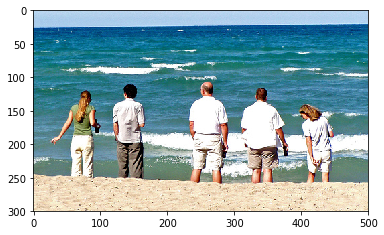

('Normal Max search:', 'Two young boys are standing on the beach .')
('Beam Search, k=3:', 'A group of people are standing on the beach .')
('Beam Search, k=5:', 'A group of young boys stand on the beach .')
('Beam Search, k=7:', 'A group of people stand on the beach .')


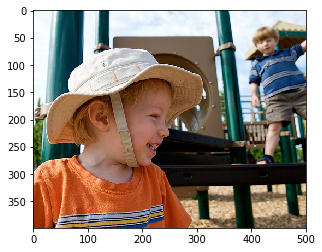

('Normal Max search:', 'A woman in a blue hat and a hat .')
('Beam Search, k=3:', 'A woman in a blue hat and a hat .')
('Beam Search, k=5:', 'A woman wearing a straw hat and a hat .')
('Beam Search, k=7:', 'A woman wearing a hat and a hat .')


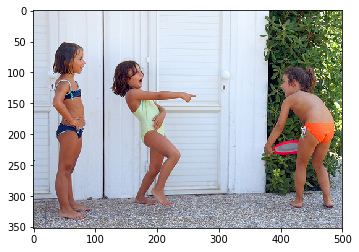

('Normal Max search:', 'A girl in a bikini is dancing in the water .')
('Beam Search, k=3:', 'A girl in a bikini is dancing in front of a sprinkler .')
('Beam Search, k=5:', 'A girl in a bikini .')
('Beam Search, k=7:', 'A girl in a bikini .')


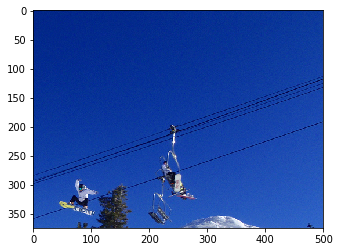

('Normal Max search:', 'A snowboarder is jumping over a high ramp .')
('Beam Search, k=3:', 'A person in a red jacket is jumping over a snowboard .')
('Beam Search, k=5:', 'A group of people jumping over a hill .')
('Beam Search, k=7:', 'A group of people jumping over a hill .')


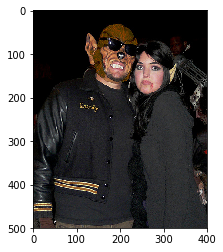

('Normal Max search:', 'A man in a black jacket and a black hat .')
('Beam Search, k=3:', 'A man and a man wearing hats .')
('Beam Search, k=5:', 'A man and a man wearing hats .')
('Beam Search, k=7:', 'A man and a man standing in front of a picture .')


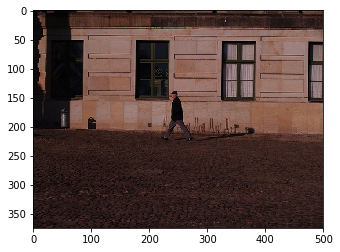

('Normal Max search:', 'A group of people are playing with a building .')
('Beam Search, k=3:', 'A group of people are standing in front of a building .')
('Beam Search, k=5:', 'A group of people are playing in front of a building .')
('Beam Search, k=7:', 'A group of people are playing in front of a building .')


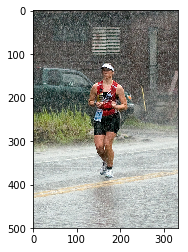

('Normal Max search:', 'A woman in a red shirt is running in a parking lot .')
('Beam Search, k=3:', 'A woman in a red shirt is running through a street .')
('Beam Search, k=5:', 'A woman in a red shirt is running in a parking lot .')
('Beam Search, k=7:', 'A woman in a red shirt is running through a street .')


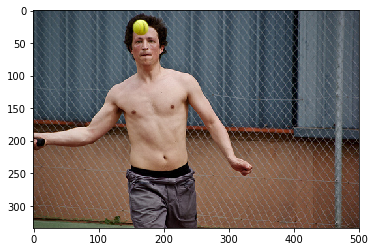

('Normal Max search:', 'A man in a blue shirt and white shorts is jumping .')
('Beam Search, k=3:', 'A man in a blue shirt and blue shorts is jumping .')
('Beam Search, k=5:', 'A man in a blue shirt and blue shorts is jumping .')
('Beam Search, k=7:', 'A man in a blue shirt and blue shorts is standing on a trampoline .')


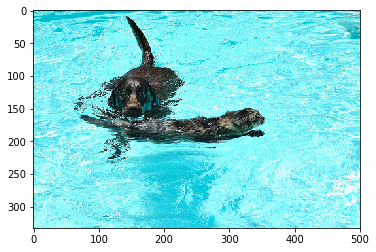

('Normal Max search:', 'A dog is swimming in the water .')
('Beam Search, k=3:', 'A brown dog is swimming in the water .')
('Beam Search, k=5:', 'A brown dog is swimming in the water .')
('Beam Search, k=7:', 'A brown dog is swimming in the water .')


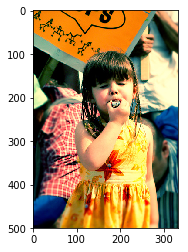

('Normal Max search:', 'A woman in a pink shirt and pink shirt is walking on a street .')
('Beam Search, k=3:', 'A young girl in a pink dress is standing in the street .')
('Beam Search, k=5:', 'A little girl in a pink dress is holding a cigarette .')
('Beam Search, k=7:', 'A little girl in a pink dress is smiling .')


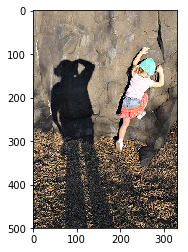

('Normal Max search:', 'A boy in a red shirt is standing on a rock .')
('Beam Search, k=3:', 'A young boy in a red shirt is standing on a rock .')
('Beam Search, k=5:', 'A little boy in a red shirt is standing on a rock .')
('Beam Search, k=7:', 'A young boy in a red shirt is standing on a sidewalk .')


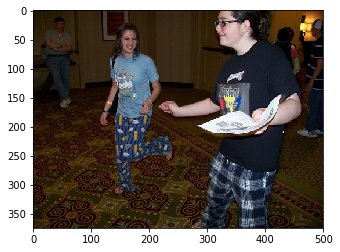

('Normal Max search:', 'A man and a woman are standing on a table .')
('Beam Search, k=3:', 'A group of people are standing on a trampoline .')
('Beam Search, k=5:', 'A group of people stand on a trampoline .')
('Beam Search, k=7:', 'A group of people pose for a picture .')


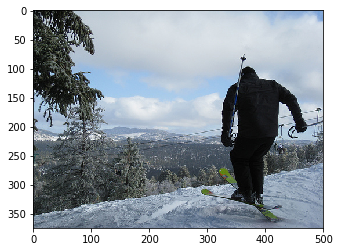

('Normal Max search:', 'A man in a red jacket and a backpack is standing on a snowy mountain .')
('Beam Search, k=3:', 'A man stands on a snowy mountain .')
('Beam Search, k=5:', 'A man stands on a snowy hill .')
('Beam Search, k=7:', 'A man stands on a snowy hill .')


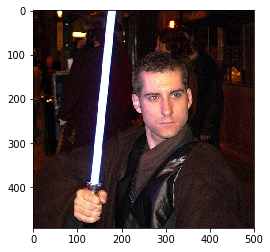

('Normal Max search:', 'A man in a red hat and a black hat is standing on a cellphone .')
('Beam Search, k=3:', 'A man in a red hat and a black hat is holding a sign .')
('Beam Search, k=5:', 'A man in a red hat and a black hat is holding a sign .')
('Beam Search, k=7:', 'A man in a red hat and a black hat .')


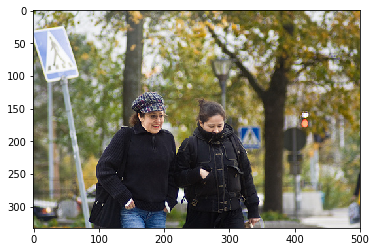

('Normal Max search:', 'A man in a black jacket and a black jacket is walking down a street .')
('Beam Search, k=3:', 'A man in a black jacket and a black jacket walks down a street .')
('Beam Search, k=5:', 'A man and a woman are walking on a street .')
('Beam Search, k=7:', 'A man and a woman are walking on a street .')


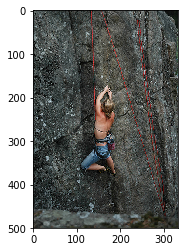

('Normal Max search:', 'A man in a red shirt and a red shirt and a white shirt and a white shirt and a man climbing a rock .')
('Beam Search, k=3:', 'A man is climbing a rock wall .')
('Beam Search, k=5:', 'A man climbs a rock face .')
('Beam Search, k=7:', 'A man climbs a rock face .')


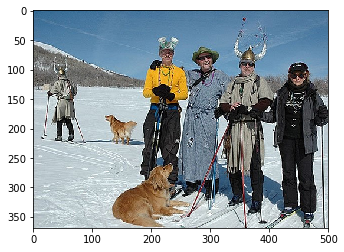

('Normal Max search:', 'A group of people are playing in the snow .')
('Beam Search, k=3:', 'A group of people play in the snow .')
('Beam Search, k=5:', 'A group of people play in the snow .')
('Beam Search, k=7:', 'A group of people play in the snow .')


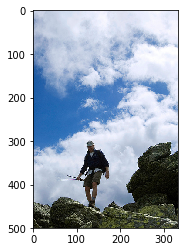

('Normal Max search:', 'A man in a red shirt and jeans is standing on a rock face .')
('Beam Search, k=3:', 'A man is standing on a cliff .')
('Beam Search, k=5:', 'A man climbs a rock face .')
('Beam Search, k=7:', 'A man stands on a rock face .')


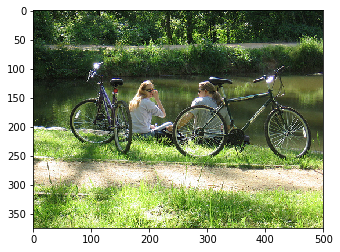

('Normal Max search:', 'A man riding a bicycle on a bicycle .')
('Beam Search, k=3:', 'A man is riding a bicycle on a bike .')
('Beam Search, k=5:', 'A man riding a bicycle .')
('Beam Search, k=7:', 'A group of people are riding on a trail .')


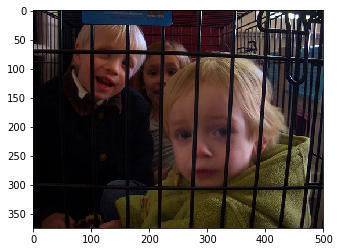

('Normal Max search:', 'A man and a woman are smiling .')
('Beam Search, k=3:', 'A young boy and a young boy are smiling .')
('Beam Search, k=5:', 'A young boy and a young boy are smiling .')
('Beam Search, k=7:', 'A young boy and a young boy are smiling .')


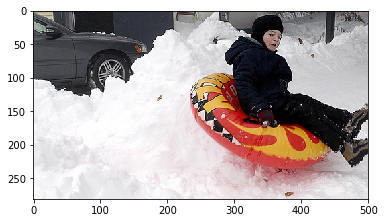

('Normal Max search:', 'Two children in a red sled in the snow .')
('Beam Search, k=3:', 'Two children are in the snow .')
('Beam Search, k=5:', 'Two children play in the snow .')
('Beam Search, k=7:', 'Two children play in the snow .')


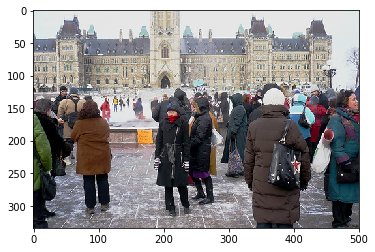

('Normal Max search:', 'A group of people are standing in front of a building .')
('Beam Search, k=3:', 'A group of people are standing in front of a building .')
('Beam Search, k=5:', 'A group of people are standing in front of a building .')
('Beam Search, k=7:', 'A group of people are standing in front of a building .')


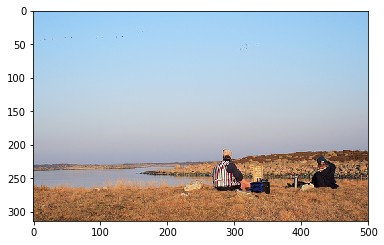

('Normal Max search:', 'A man and a woman are standing on a beach .')
('Beam Search, k=3:', 'Two people are standing on a beach .')
('Beam Search, k=5:', 'Two people stand on a beach .')
('Beam Search, k=7:', 'Two people stand on a beach .')


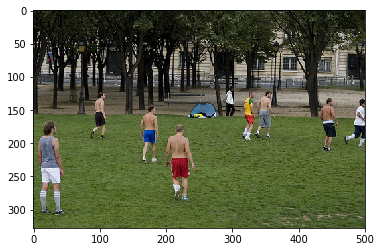

('Normal Max search:', 'A group of children playing in a yard .')
('Beam Search, k=3:', 'A group of children playing in front of a building .')
('Beam Search, k=5:', 'A group of children playing in front of a building .')
('Beam Search, k=7:', 'A group of children playing in front of a building .')


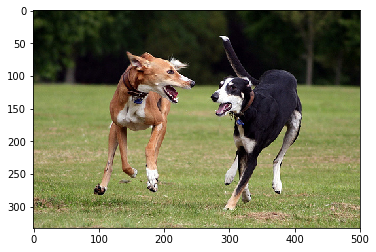

('Normal Max search:', 'Two dogs are running in the grass .')
('Beam Search, k=3:', 'Two dogs are running in the grass .')
('Beam Search, k=5:', 'Two dogs are running in the grass .')
('Beam Search, k=7:', 'Two dogs are running in the grass .')


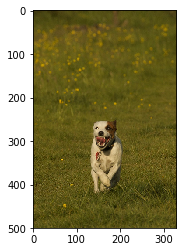

('Normal Max search:', 'A white and white dog runs through a field .')
('Beam Search, k=3:', 'A white and white dog is running through the grass .')
('Beam Search, k=5:', 'A white and white dog is running through the grass .')
('Beam Search, k=7:', 'A white and white dog is running through the grass .')


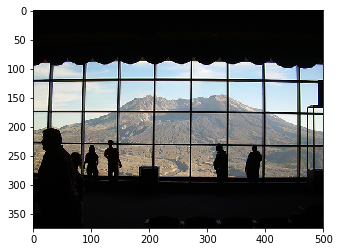

('Normal Max search:', 'A couple in a white shirt and black pants is standing in front of a building .')
('Beam Search, k=3:', 'A man and a woman stand in front of a building .')
('Beam Search, k=5:', 'A man and a woman stand in front of a building .')
('Beam Search, k=7:', 'A man and a woman stand in front of a building .')


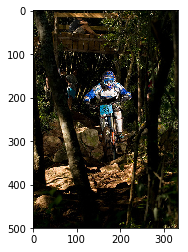

('Normal Max search:', 'A man is riding a bike in a forest .')
('Beam Search, k=3:', 'A man in a helmet is riding a mountain bike .')
('Beam Search, k=5:', 'A mountain biker on a hill .')
('Beam Search, k=7:', 'A mountain biker on a slope .')


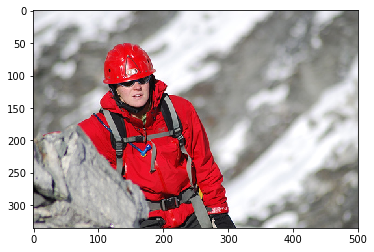

('Normal Max search:', 'A man wearing a helmet is skiing down a snowy hill .')
('Beam Search, k=3:', 'A man wearing a red helmet and a helmet .')
('Beam Search, k=5:', 'A man wearing a helmet and a helmet .')
('Beam Search, k=7:', 'A man wearing a red helmet and helmet .')


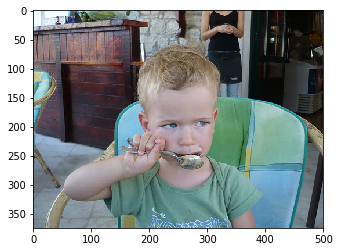

('Normal Max search:', 'A boy is playing with a bubble .')
('Beam Search, k=3:', 'A little boy is playing with a bubble .')
('Beam Search, k=5:', 'A little boy in a red shirt is blowing bubbles .')
('Beam Search, k=7:', 'A little boy in a red shirt is blowing bubbles .')


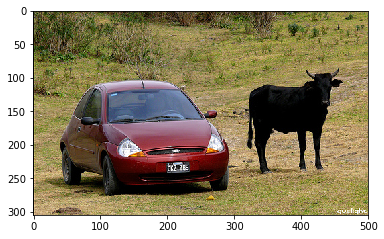

('Normal Max search:', 'A man and a woman are riding a bull .')
('Beam Search, k=3:', 'A man and a woman are riding a bull .')
('Beam Search, k=5:', 'A group of people are riding a bull .')
('Beam Search, k=7:', 'A group of people pulling a bull .')


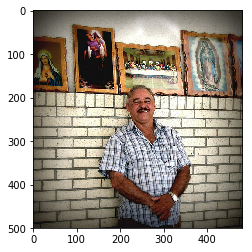

('Normal Max search:', 'A man in a white shirt and a white shirt is standing on a wall .')
('Beam Search, k=3:', 'A man in a white shirt and a white shirt stands on a wall .')
('Beam Search, k=5:', 'A man in a red shirt and a white shirt .')
('Beam Search, k=7:', 'A man in a red shirt and a white shirt .')


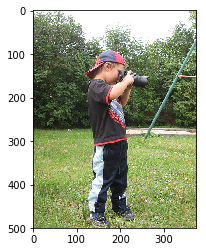

('Normal Max search:', 'A boy in a red shirt and white shorts is playing with a bat .')
('Beam Search, k=3:', 'A young boy in a red shirt and a white shirt is playing with a bat .')
('Beam Search, k=5:', 'A little boy in a red shirt and a white shirt is holding a bat .')
('Beam Search, k=7:', 'A little boy in a red shirt and a white shirt is playing .')


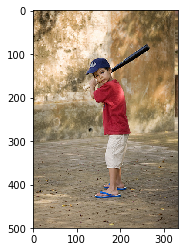

('Normal Max search:', 'A boy in a blue shirt and blue pants is standing on a sidewalk .')
('Beam Search, k=3:', 'A young boy in a blue shirt and a white shirt is standing on a sidewalk .')
('Beam Search, k=5:', 'A young boy in a blue shirt and a white shirt .')
('Beam Search, k=7:', 'A young boy in a blue shirt and a white shirt .')


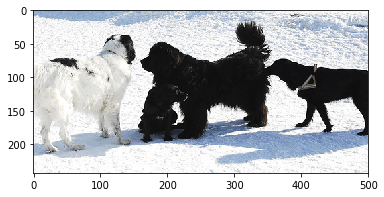

('Normal Max search:', 'Two dogs are playing in the snow .')
('Beam Search, k=3:', 'Two dogs play in the snow .')
('Beam Search, k=5:', 'Two dogs play in the snow .')
('Beam Search, k=7:', 'Two dogs play in the snow .')


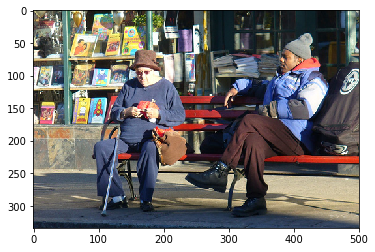

('Normal Max search:', 'A man in a black shirt and a black shirt is sitting on a table .')
('Beam Search, k=3:', 'A man is sitting on a bench .')
('Beam Search, k=5:', 'A man is sitting on a bench .')
('Beam Search, k=7:', 'A man is sitting on a bench .')


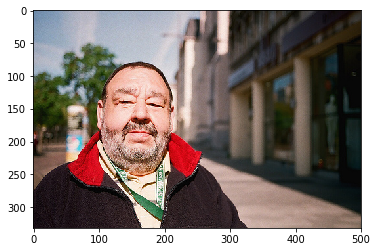

('Normal Max search:', 'A man in a red jacket and a blue jacket .')
('Beam Search, k=3:', 'A man in a red jacket and a blue jacket .')
('Beam Search, k=5:', 'A man in a red jacket .')
('Beam Search, k=7:', 'A man in a red jacket .')


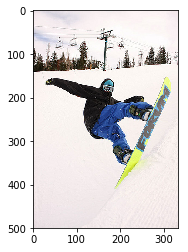

('Normal Max search:', 'A snowboarder is jumping over a snow covered hill .')
('Beam Search, k=3:', 'A man in a red jacket is snowboarding .')
('Beam Search, k=5:', 'A man in a red jacket is snowboarding .')
('Beam Search, k=7:', 'A man in a red jacket .')


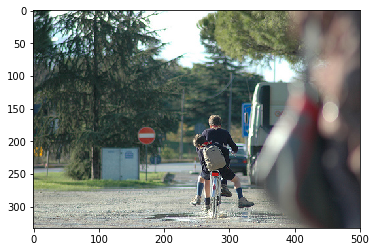

('Normal Max search:', 'A man riding a bike down a road .')
('Beam Search, k=3:', 'A group of people are riding down a road .')
('Beam Search, k=5:', 'A group of people are riding down a road .')
('Beam Search, k=7:', 'A group of people are riding down a racetrack .')


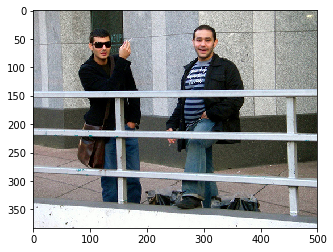

('Normal Max search:', 'A man and woman in a white coat and black pants , and black pants .')
('Beam Search, k=3:', 'A man and a woman in a white shirt are looking against a building .')
('Beam Search, k=5:', 'A man and a woman in a white shirt are looking against steps .')
('Beam Search, k=7:', 'A man and a woman in a white shirt looking against a building .')


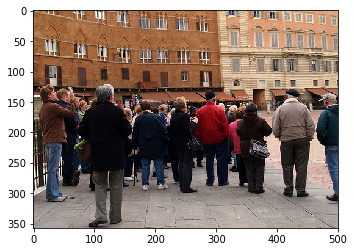

('Normal Max search:', 'A group of people are standing in front of a building .')
('Beam Search, k=3:', 'A group of people are standing in front of a building .')
('Beam Search, k=5:', 'A group of people are standing outside .')
('Beam Search, k=7:', 'A group of people are standing outside .')


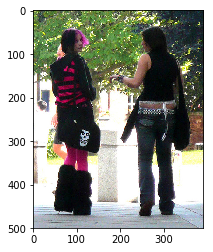

('Normal Max search:', 'A woman in a red shirt and a white shirt walks down a sidewalk .')
('Beam Search, k=3:', 'A woman and a woman stand in front of a building .')
('Beam Search, k=5:', 'A woman and a woman stand in front of a building .')
('Beam Search, k=7:', 'A woman and a woman stand in front of a building .')


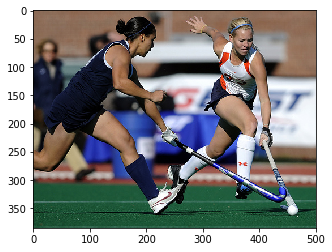

('Normal Max search:', 'A man in a red shirt and white shorts is running on a track .')
('Beam Search, k=3:', 'A man in a red shirt is running on a track .')
('Beam Search, k=5:', 'A man in a red shirt is running on a track .')
('Beam Search, k=7:', 'A man in a red shirt is running on a match .')


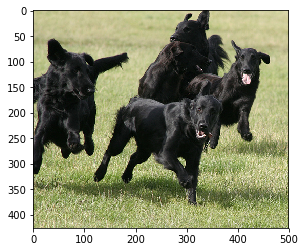

('Normal Max search:', 'Two dogs run through the grass .')
('Beam Search, k=3:', 'A black dog and a black dog are running in the grass .')
('Beam Search, k=5:', 'A black dog and a black dog are running in the grass .')
('Beam Search, k=7:', 'A black dog and a black dog are running .')


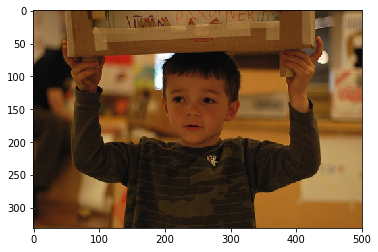

('Normal Max search:', 'A man in a black shirt and a black shirt is looking at a table .')
('Beam Search, k=3:', 'A man in a black shirt and black jacket is standing in front of a store .')
('Beam Search, k=5:', 'A man in a black shirt and black shirt is standing in front of a building .')
('Beam Search, k=7:', 'A young boy wearing a black shirt is standing in front of a building .')


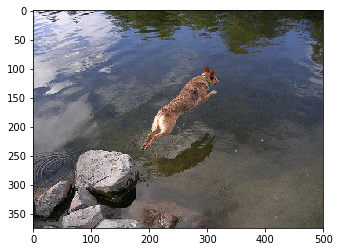

('Normal Max search:', 'A brown dog is jumping into the water .')
('Beam Search, k=3:', 'A brown and white dog is swimming in the water .')
('Beam Search, k=5:', 'A brown and white dog swimming in the water .')
('Beam Search, k=7:', 'A brown and white dog swimming in the water .')


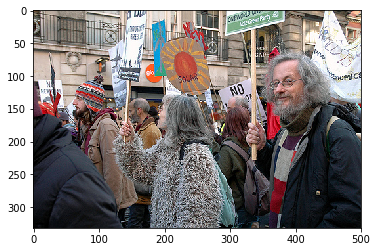

('Normal Max search:', 'A man in a red hat and hat is standing in a busy street .')
('Beam Search, k=3:', 'A man in a red hat and a crowd .')
('Beam Search, k=5:', 'A man in a red hat and a crowd .')
('Beam Search, k=7:', 'A group of people dressed in a busy street .')


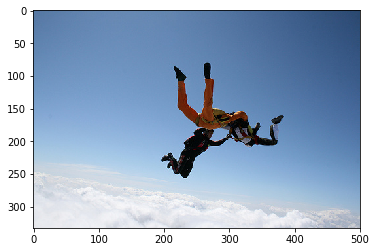

('Normal Max search:', 'A man in a yellow shirt and white pants is jumping into the air .')
('Beam Search, k=3:', 'A man jumps into the air .')
('Beam Search, k=5:', 'A man jumps into the air .')
('Beam Search, k=7:', 'A man jumps into the air .')


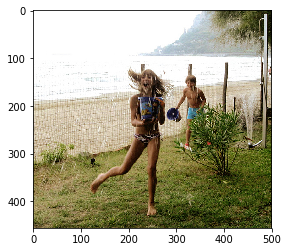

('Normal Max search:', 'Two girls are playing in a trampoline .')
('Beam Search, k=3:', 'A young girl in a pink dress is running on a sidewalk .')
('Beam Search, k=5:', 'A little girl in a pink dress is running on a sidewalk .')
('Beam Search, k=7:', 'A little girl in a pink dress is running on a sidewalk .')


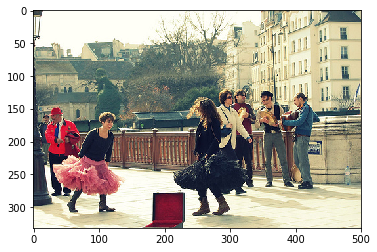

('Normal Max search:', 'A group of people are standing on a stage .')
('Beam Search, k=3:', 'A group of people are standing in front of a building .')
('Beam Search, k=5:', 'A group of people are standing in front of a building .')
('Beam Search, k=7:', 'A group of people are standing in front of a building .')


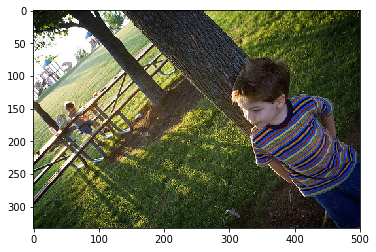

('Normal Max search:', 'A young girl in a blue shirt and blue shirt is climbing a fence .')
('Beam Search, k=3:', 'A young girl in a blue shirt is climbing a fence .')
('Beam Search, k=5:', 'A young girl in a blue shirt is climbing a fence .')
('Beam Search, k=7:', 'A little girl in a blue shirt is climbing a fence .')


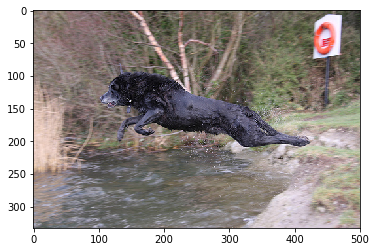

('Normal Max search:', 'A black dog is swimming in the water .')
('Beam Search, k=3:', 'A black dog plays in the water .')
('Beam Search, k=5:', 'A black dog swims in the water .')
('Beam Search, k=7:', 'A black dog swims in the water .')


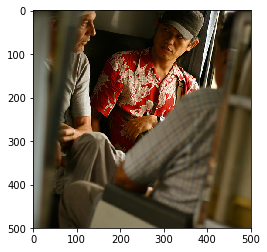

('Normal Max search:', 'A man and a woman sit on a bench .')
('Beam Search, k=3:', 'A man sits on a subway bench .')
('Beam Search, k=5:', 'A man sits on a bench .')
('Beam Search, k=7:', 'A man sits on a bench .')


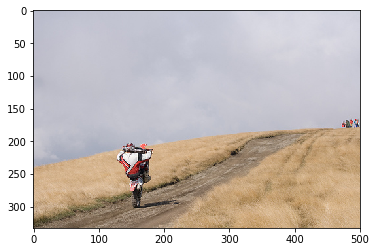

('Normal Max search:', 'A man in a red shirt is riding a dirt bike .')
('Beam Search, k=3:', 'A group of people on a dirt hill .')
('Beam Search, k=5:', 'A group of people on a dirt hill .')
('Beam Search, k=7:', 'A group of people on a dirt hill .')


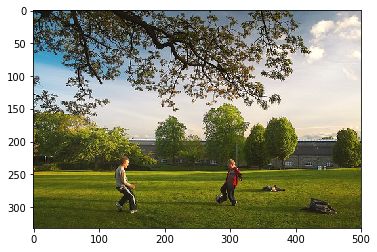

('Normal Max search:', 'A group of people playing soccer in a field .')
('Beam Search, k=3:', 'A group of people playing soccer in a field .')
('Beam Search, k=5:', 'A group of people playing soccer .')
('Beam Search, k=7:', 'A group of people playing soccer .')


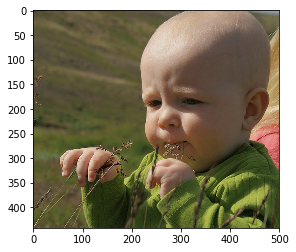

('Normal Max search:', 'A boy in a red shirt is blowing bubbles .')
('Beam Search, k=3:', 'A young boy in a red shirt is blowing bubbles .')
('Beam Search, k=5:', 'A little boy in a red shirt is blowing bubbles .')
('Beam Search, k=7:', 'A little boy in a red shirt is blowing bubbles .')


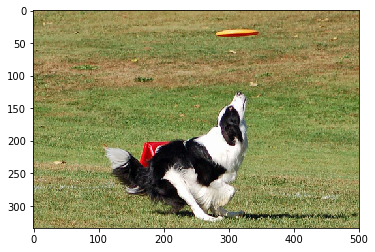

('Normal Max search:', 'A black and white dog jumps over a Frisbee .')
('Beam Search, k=3:', 'A black and white dog jumps over a yellow Frisbee .')
('Beam Search, k=5:', 'A black and white dog catches a Frisbee .')
('Beam Search, k=7:', 'A black and white dog catching a Frisbee .')


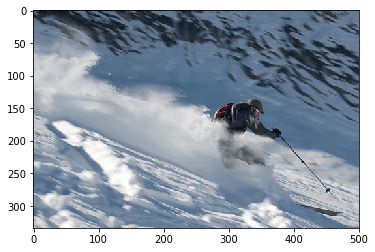

('Normal Max search:', 'A skier is jumping over a snow covered hill .')
('Beam Search, k=3:', 'A skier is jumping over a snow slope .')
('Beam Search, k=5:', 'A skier is jumping over a snow covered hill .')
('Beam Search, k=7:', 'A skier is jumping over a hill .')


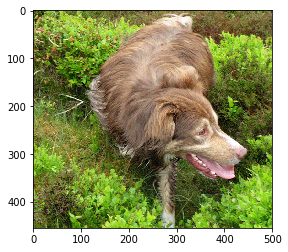

('Normal Max search:', 'A brown dog is running on a green grass .')
('Beam Search, k=3:', 'A brown and white dog is running through the grass .')
('Beam Search, k=5:', 'A brown and white dog is standing in the grass .')
('Beam Search, k=7:', 'A brown and white dog is playing with a toy .')


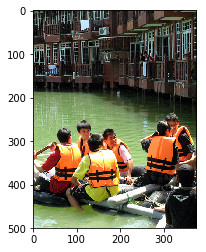

('Normal Max search:', 'A group of people are sitting on a raft .')
('Beam Search, k=3:', 'A group of people are sitting in the water .')
('Beam Search, k=5:', 'A group of people sitting in the water .')
('Beam Search, k=7:', 'A group of people sitting in the water .')


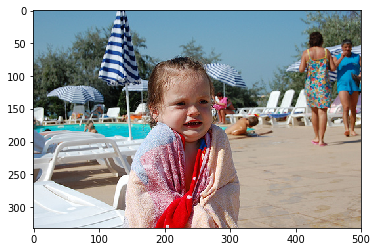

('Normal Max search:', 'A woman in a pink shirt and a girl in a pink shirt and a girl in a pink shirt and a girl in a white dress .')
('Beam Search, k=3:', 'A little girl in a pink shirt is standing in the water .')
('Beam Search, k=5:', 'A little girl in a pink shirt is sitting in the water .')
('Beam Search, k=7:', 'A little girl in a pink shirt sits in the water .')


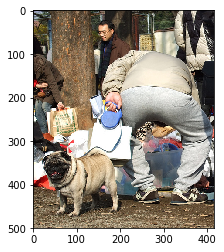

('Normal Max search:', 'A man and a woman are playing with a small small small small small small white and white and white dog .')
('Beam Search, k=3:', 'A man and a woman are playing with a white dog .')
('Beam Search, k=5:', 'A group of people are looking at a table .')
('Beam Search, k=7:', 'A group of people are looking at a bar .')


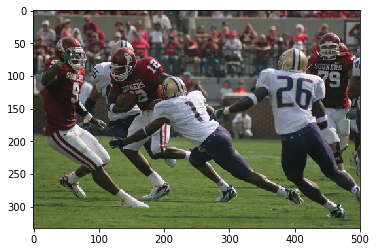

('Normal Max search:', 'A football player in a red jersey is running down the ground .')
('Beam Search, k=3:', 'A football player in red and white jersey is tackling the ball .')
('Beam Search, k=5:', 'A football player in a red jersey is tackling the ball .')
('Beam Search, k=7:', 'A football player is tackling the ball .')


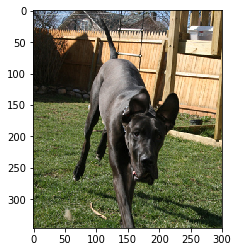

('Normal Max search:', 'A black dog is playing with a red toy .')
('Beam Search, k=3:', 'A black dog and a black dog playing with a red toy .')
('Beam Search, k=5:', 'A black dog and a black dog playing with a toy .')
('Beam Search, k=7:', 'A black dog and a black dog .')


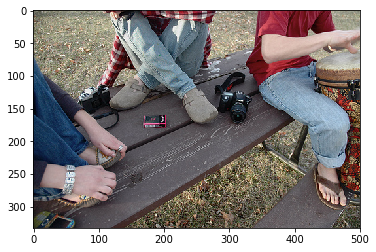

('Normal Max search:', 'A man in a red shirt is sitting on a bench .')
('Beam Search, k=3:', 'A man in a red shirt is sitting on a bench .')
('Beam Search, k=5:', 'A man in a red shirt is sitting on a bench .')
('Beam Search, k=7:', 'A little boy is sitting on a bench .')


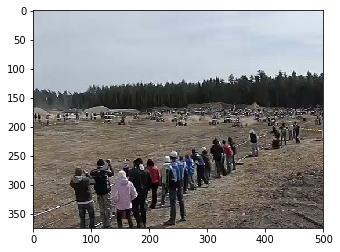

('Normal Max search:', 'A group of people are walking through a river .')
('Beam Search, k=3:', 'A group of people are standing on a hill .')
('Beam Search, k=5:', 'A group of people on a hill .')
('Beam Search, k=7:', 'A group of people stand on a hill .')


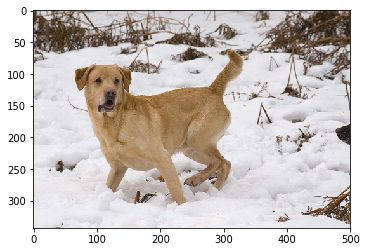

('Normal Max search:', 'Two dogs are playing in the snow .')
('Beam Search, k=3:', 'Two brown dogs play in the snow .')
('Beam Search, k=5:', 'Two brown dogs in the snow .')
('Beam Search, k=7:', 'Two brown dogs in the snow .')


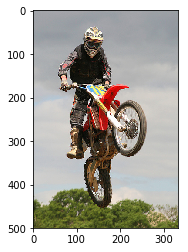

('Normal Max search:', 'A man in a red helmet and helmet is riding a motorbike .')
('Beam Search, k=3:', 'A man in a red helmet is riding a turn .')
('Beam Search, k=5:', 'A man on a motorcycle .')
('Beam Search, k=7:', 'A man on a motorcycle .')


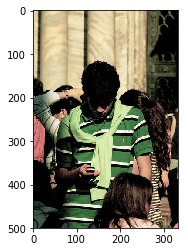

('Normal Max search:', 'A man and a woman are sitting in a park .')
('Beam Search, k=3:', 'A group of people are looking at a picture .')
('Beam Search, k=5:', 'A group of people are looking at a table .')
('Beam Search, k=7:', 'A group of people are sitting in front of a building .')


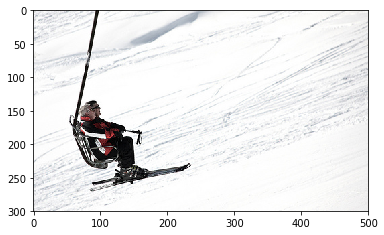

('Normal Max search:', 'A skier is skiing down a slope .')
('Beam Search, k=3:', 'A skier in the snow .')
('Beam Search, k=5:', 'A skier in the snow .')
('Beam Search, k=7:', 'A skier in the snow .')


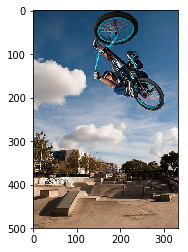

('Normal Max search:', 'A man is performing a trick on a bicycle trick .')
('Beam Search, k=3:', 'A man is performing a trick on a ramp .')
('Beam Search, k=5:', 'A man is performing a trick on a ramp .')
('Beam Search, k=7:', 'A man is performing a trick on a ramp .')


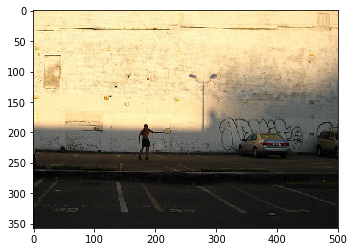

('Normal Max search:', 'A man is driving a trick on a street .')
('Beam Search, k=3:', 'A group of people on the street .')
('Beam Search, k=5:', 'A group of people on the street .')
('Beam Search, k=7:', 'A group of people on the street .')


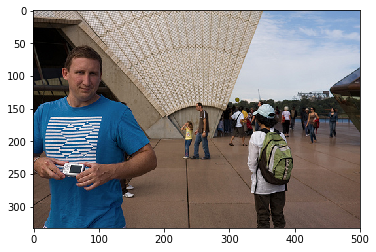

('Normal Max search:', 'A man in a red shirt is standing in a street .')
('Beam Search, k=3:', 'A man in a red shirt is standing in front of a crowd .')
('Beam Search, k=5:', 'A man in a red shirt stands in front of a crowd .')
('Beam Search, k=7:', 'A man in a red shirt with a sign .')


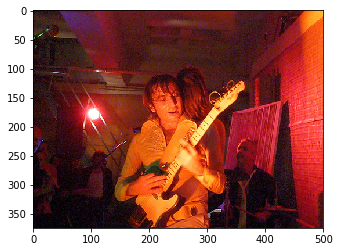

('Normal Max search:', 'A man in a red shirt plays guitar .')
('Beam Search, k=3:', 'A man plays a guitar .')
('Beam Search, k=5:', 'A man plays a guitar .')
('Beam Search, k=7:', 'A man plays a guitar .')


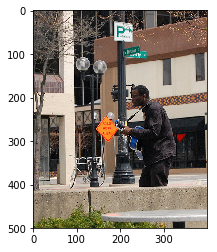

('Normal Max search:', 'A man in a red shirt and a white shirt is standing on a sidewalk .')
('Beam Search, k=3:', 'A man in a red shirt and a white hat is standing on a sidewalk .')
('Beam Search, k=5:', 'A man in a red shirt and a white hat is standing on a sidewalk .')
('Beam Search, k=7:', 'A man in a red shirt and a white hat is standing on a sidewalk .')


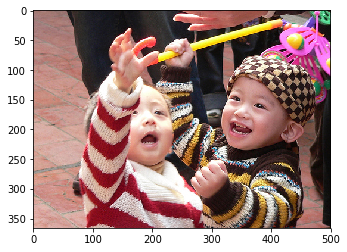

('Normal Max search:', 'A little boy is playing with a boy in a colorful and blue shirt and a boy in a pink shirt .')
('Beam Search, k=3:', 'A little boy is playing with a toy .')
('Beam Search, k=5:', 'A little boy is playing with a toy .')
('Beam Search, k=7:', 'A little boy is playing with a toy .')


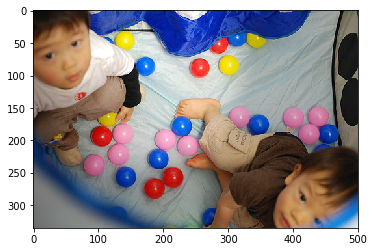

('Normal Max search:', 'A little boy is sitting on a colorful inflatable seat .')
('Beam Search, k=3:', 'Two children are sitting on a bed .')
('Beam Search, k=5:', 'Two children are sitting on a bed .')
('Beam Search, k=7:', 'Two children sitting on a bed .')


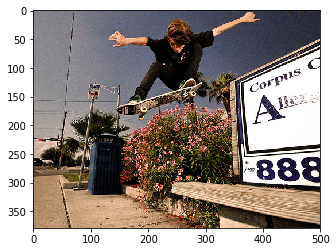

('Normal Max search:', 'A man in a white shirt and white shirt is skateboarding .')
('Beam Search, k=3:', 'A man doing a trick .')
('Beam Search, k=5:', 'A man doing a trick .')
('Beam Search, k=7:', 'A man doing a trick .')


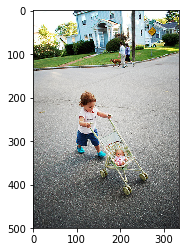

('Normal Max search:', 'A boy in a red shirt is playing with a toy .')
('Beam Search, k=3:', 'A little boy in a red shirt is standing on a street .')
('Beam Search, k=5:', 'A little boy in a red shirt is standing on a street .')
('Beam Search, k=7:', 'A little boy in a red shirt is holding a ball .')


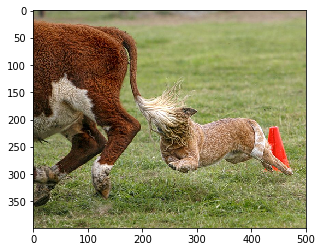

('Normal Max search:', 'A brown and white dog is running through a grassy field .')
('Beam Search, k=3:', 'A brown and white dog is jumping over a hurdle .')
('Beam Search, k=5:', 'A brown and white dog jumps over a hurdle .')
('Beam Search, k=7:', 'A brown and white dog jumps over a hurdle .')


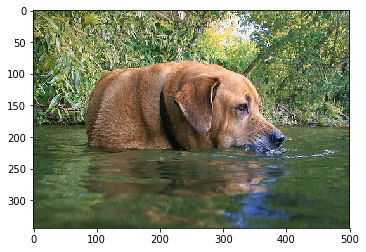

('Normal Max search:', 'A brown dog is playing with a green ball .')
('Beam Search, k=3:', 'A brown dog is trying to catch a ball .')
('Beam Search, k=5:', 'A brown dog is trying to catch a ball .')
('Beam Search, k=7:', 'A brown dog is trying to catch a ball .')


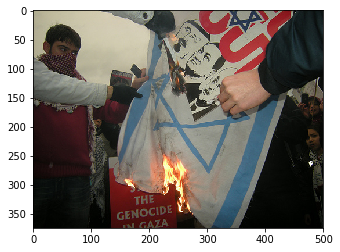

('Normal Max search:', 'A man in a red shirt and a red hat is holding a red mask .')
('Beam Search, k=3:', 'A man in a red shirt is holding a sign .')
('Beam Search, k=5:', 'A man in a red shirt is holding a sign .')
('Beam Search, k=7:', 'A group of people standing in front of a building .')


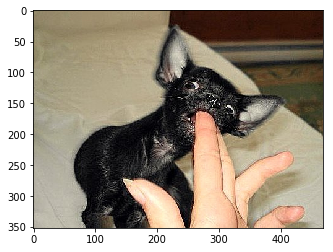

('Normal Max search:', 'A black dog is looking at a black dog .')
('Beam Search, k=3:', 'A black dog and a black dog are standing on a bed .')
('Beam Search, k=5:', 'A black dog and a black dog on a bed .')
('Beam Search, k=7:', 'A black dog and a black dog are standing on a sidewalk .')


In [50]:
import matplotlib.pyplot as plt
%matplotlib inline

for i in range(100):
    try_image = test_img[i]
    im = Image.open(try_image)
    plt.figure()
    plt.imshow(np.asarray(im))
    plt.show()
    print ('Normal Max search:', predict_captions(try_image)) 
    print ('Beam Search, k=3:', beam_search_predictions(try_image, beam_index=3))
    print ('Beam Search, k=5:', beam_search_predictions(try_image, beam_index=5))
    print ('Beam Search, k=7:', beam_search_predictions(try_image, beam_index=7))

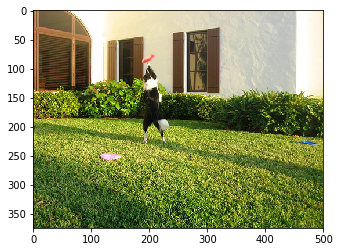

('Normal Max search:', 'A black dog is trying to catch a ball .')
('Beam Search, k=3:', 'A black and white dog is trying to catch a ball .')
('Beam Search, k=5:', 'A black and white dog is trying to catch a ball .')
('Beam Search, k=7:', 'A black and white dog catches a tennis ball .')


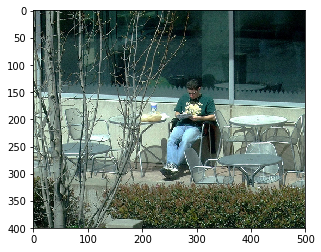

('Normal Max search:', 'A woman is sitting on a bench .')
('Beam Search, k=3:', 'A young boy is sitting on a bench .')
('Beam Search, k=5:', 'A little girl is sitting on a bench .')
('Beam Search, k=7:', 'A woman in a pink shirt is sitting on a bench .')


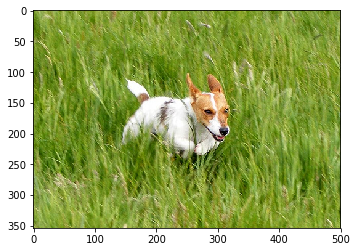

('Normal Max search:', 'A white and white dog is running through the grass .')
('Beam Search, k=3:', 'A white and white dog is running through the grass .')
('Beam Search, k=5:', 'A black and white dog is running through the grass .')
('Beam Search, k=7:', 'A black and white dog is running through the grass .')


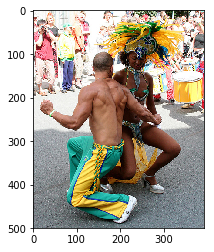

('Normal Max search:', 'A man in a red shirt and a red shirt is standing in a parade .')
('Beam Search, k=3:', 'A man in a red shirt and black shorts is dancing .')
('Beam Search, k=5:', 'A group of people are standing in front of a parade .')
('Beam Search, k=7:', 'A group of young men stand in the street .')


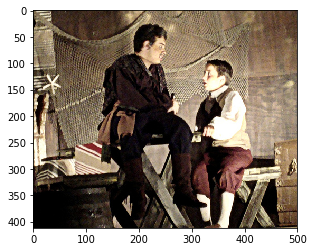

('Normal Max search:', 'A man and a woman are sitting on a street .')
('Beam Search, k=3:', 'A man and a woman are sitting on a sidewalk .')
('Beam Search, k=5:', 'A man and a woman are sitting on a building .')
('Beam Search, k=7:', 'A group of people stand in front of a building .')


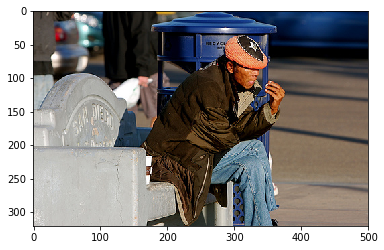

('Normal Max search:', 'A man in a black hat and a white hat .')
('Beam Search, k=3:', 'A man in a black hat and sunglasses is sitting on a cigarette .')
('Beam Search, k=5:', 'A man sits on a bench .')
('Beam Search, k=7:', 'A man sits on a bench .')


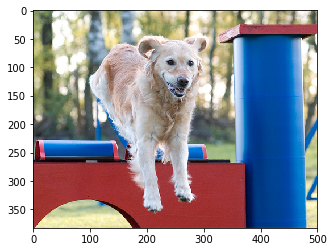

('Normal Max search:', 'A dog is jumping over a green toy .')
('Beam Search, k=3:', 'A white dog is jumping over a hurdle .')
('Beam Search, k=5:', 'A white dog is jumping over a hurdle .')
('Beam Search, k=7:', 'A white dog is jumping over a hurdle .')


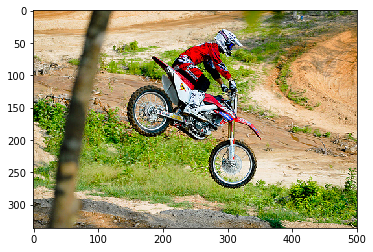

('Normal Max search:', 'A man in a helmet and helmet is riding a bicycle .')
('Beam Search, k=3:', 'A man in a helmet is riding a bicycle .')
('Beam Search, k=5:', 'A man wearing a helmet is riding a bicycle .')
('Beam Search, k=7:', 'A man riding a bicycle over a hill .')


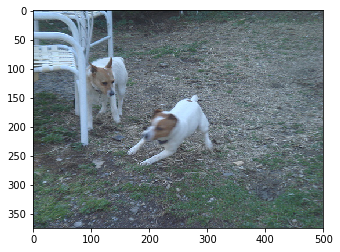

('Normal Max search:', 'A white dog is playing with a small white dog .')
('Beam Search, k=3:', 'A white dog and a white dog play with a white dog .')
('Beam Search, k=5:', 'A white and white dog plays with a white dog .')
('Beam Search, k=7:', 'A white and white dog plays with a white dog .')


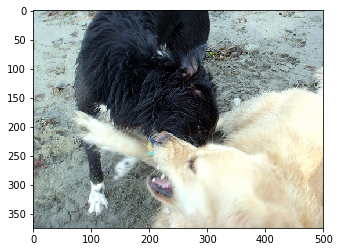

('Normal Max search:', 'Two dogs are playing with a red ball .')
('Beam Search, k=3:', 'Two dogs are playing with each other .')
('Beam Search, k=5:', 'Two dogs are playing with each other .')
('Beam Search, k=7:', 'Two dogs are playing with each other .')


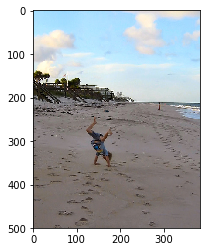

('Normal Max search:', 'Two girls are playing in the beach .')
('Beam Search, k=3:', 'A group of people play in the beach .')
('Beam Search, k=5:', 'A group of people play in the beach .')
('Beam Search, k=7:', 'A group of people play in the beach .')


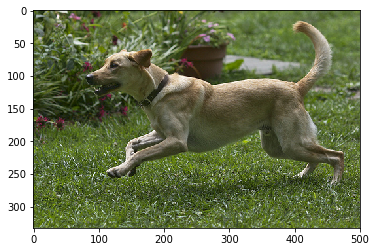

('Normal Max search:', 'A brown dog is running through a grassy field .')
('Beam Search, k=3:', 'A brown dog runs through the grass .')
('Beam Search, k=5:', 'A brown dog runs through the grass .')
('Beam Search, k=7:', 'A brown dog runs through the grass .')


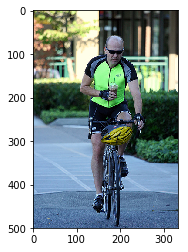

('Normal Max search:', 'A man in a red shirt and a helmet is riding a bicycle .')
('Beam Search, k=3:', 'A man wearing a helmet is riding a bicycle .')
('Beam Search, k=5:', 'A man is riding a bicycle .')
('Beam Search, k=7:', 'A man riding a bicycle .')


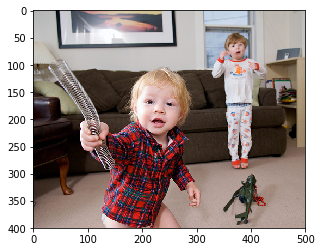

('Normal Max search:', 'A little boy in a red shirt and a white shirt is playing on a bed .')
('Beam Search, k=3:', 'A little boy in a red shirt is playing on a bed .')
('Beam Search, k=5:', 'A little boy in a red shirt is playing on a bed .')
('Beam Search, k=7:', 'A little boy in a red shirt is holding a toy .')


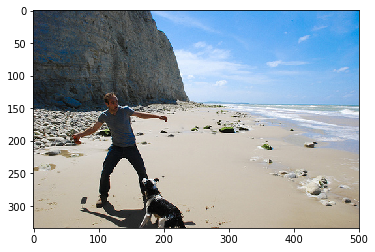

('Normal Max search:', 'A girl in a bikini is walking on the beach .')
('Beam Search, k=3:', 'A young girl is walking along the beach .')
('Beam Search, k=5:', 'A young girl stands on the beach .')
('Beam Search, k=7:', 'A little girl is walking along the beach .')


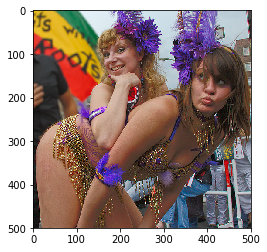

('Normal Max search:', 'A girl in a pink dress is dancing in the air .')
('Beam Search, k=3:', 'A girl in a pink dress is holding her head .')
('Beam Search, k=5:', 'A girl in a pink dress is dancing .')
('Beam Search, k=7:', 'A young girl in a pink dress is dancing .')


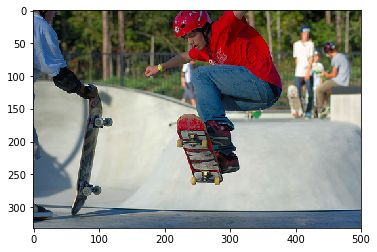

('Normal Max search:', 'A boy in a red helmet and a helmet is riding a red helmet .')
('Beam Search, k=3:', 'A young boy in a red helmet and a helmet is riding a ride .')
('Beam Search, k=5:', 'A young boy in a red helmet and a helmet is wearing a helmet .')
('Beam Search, k=7:', 'A little boy in a red helmet and a helmet is wearing a helmet .')


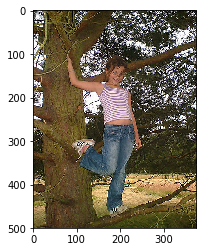

('Normal Max search:', 'A young boy in a red shirt and white pants is jumping on a tree .')
('Beam Search, k=3:', 'A young boy in a red shirt is jumping on a rock .')
('Beam Search, k=5:', 'A young boy in the air .')
('Beam Search, k=7:', 'A young boy in the air .')


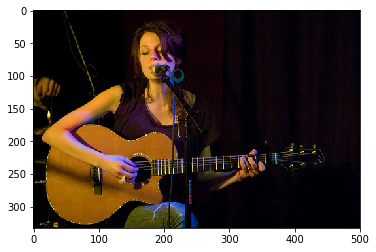

('Normal Max search:', 'A woman in a red shirt and a white shirt is playing guitar .')
('Beam Search, k=3:', 'A woman in a red dress plays guitar .')
('Beam Search, k=5:', 'A woman in a pink dress plays guitar .')
('Beam Search, k=7:', 'A woman and a woman playing guitar .')


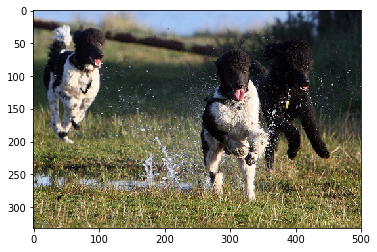

('Normal Max search:', 'A black and white dog is playing with a tennis ball in its mouth .')
('Beam Search, k=3:', 'A black and white dog is playing with a tennis ball in its mouth .')
('Beam Search, k=5:', 'A black and white dog playing with a tennis ball in its mouth .')
('Beam Search, k=7:', 'A black and white dog playing with a tennis ball in its mouth .')


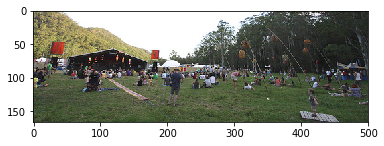

('Normal Max search:', 'A group of people are riding a fire with a crowd .')
('Beam Search, k=3:', 'A group of people are riding in front of a crowd .')
('Beam Search, k=5:', 'A group of people sit on a road .')
('Beam Search, k=7:', 'A group of people sit on a road .')


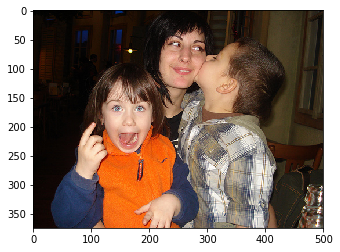

('Normal Max search:', 'Two young girls are smiling .')
('Beam Search, k=3:', 'A woman and a woman pose for a picture .')
('Beam Search, k=5:', 'A woman and a woman pose for a picture .')
('Beam Search, k=7:', 'A woman and a woman pose for a picture .')


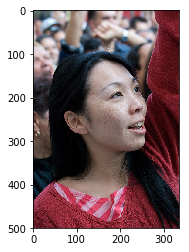

('Normal Max search:', 'A woman with a red shirt and a woman in a red shirt .')
('Beam Search, k=3:', 'A young girl in a pink shirt is smiling .')
('Beam Search, k=5:', 'A young girl in a pink shirt is smiling .')
('Beam Search, k=7:', 'A young girl in a pink shirt smiles .')


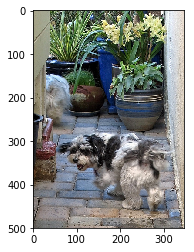

('Normal Max search:', 'A small dog is playing with a toy .')
('Beam Search, k=3:', 'Two dogs are playing in the grass .')
('Beam Search, k=5:', 'Two dogs are playing together .')
('Beam Search, k=7:', 'Two dogs are playing together .')


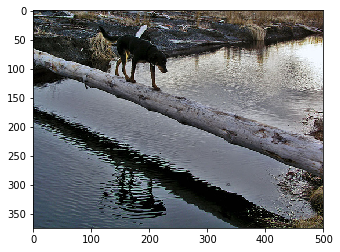

('Normal Max search:', 'A black and white dog is walking through a river .')
('Beam Search, k=3:', 'A black and white dog is jumping in the water .')
('Beam Search, k=5:', 'A black and white dog is playing in the water .')
('Beam Search, k=7:', 'A black and white dog is playing in the water .')


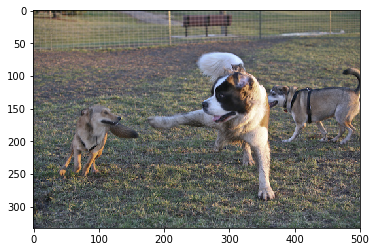

('Normal Max search:', 'Two dogs play with a ball .')
('Beam Search, k=3:', 'Two dogs are playing with each other .')
('Beam Search, k=5:', 'Two dogs are playing with each other .')
('Beam Search, k=7:', 'Two dogs play in the grass .')


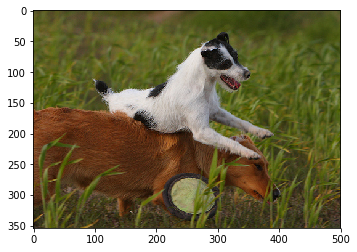

('Normal Max search:', 'A white and white dog is running through a grassy field .')
('Beam Search, k=3:', 'A brown and white dog is playing with a white ball .')
('Beam Search, k=5:', 'A brown and white dog is playing with a toy .')
('Beam Search, k=7:', 'A brown and white dog is playing with a toy .')


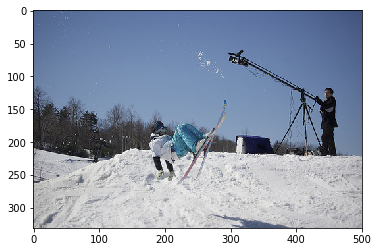

('Normal Max search:', 'A group of people are pulling a sled .')
('Beam Search, k=3:', 'A group of people pulling a sled .')
('Beam Search, k=5:', 'A group of people pulling a sled .')
('Beam Search, k=7:', 'A group of people pulling a sled .')


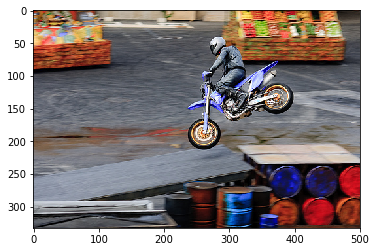

('Normal Max search:', 'A man in a helmet and a helmet is riding a bicycle .')
('Beam Search, k=3:', 'A man is riding a bicycle .')
('Beam Search, k=5:', 'A man is riding a bicycle .')
('Beam Search, k=7:', 'A man is riding a bicycle .')


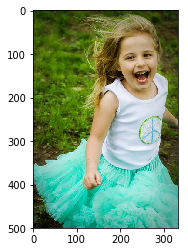

('Normal Max search:', 'A girl in a pink dress is holding a pink dress .')
('Beam Search, k=3:', 'A little girl in a pink dress is wearing a pink dress .')
('Beam Search, k=5:', 'A little girl in a pink dress is standing in front of flowers .')
('Beam Search, k=7:', 'A little girl in a pink dress .')


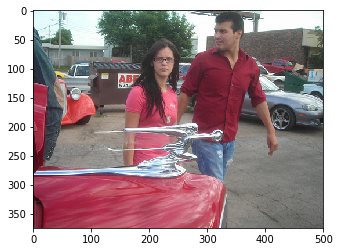

('Normal Max search:', 'A woman in a red shirt is riding a cart .')
('Beam Search, k=3:', 'A woman in a red shirt is riding a cart .')
('Beam Search, k=5:', 'A woman in a red shirt is riding a car .')
('Beam Search, k=7:', 'A woman in a red shirt is riding a car .')


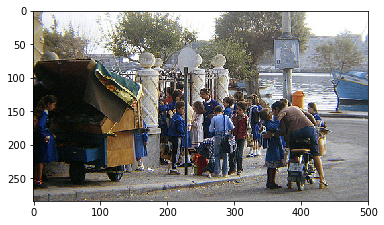

('Normal Max search:', 'A woman in a red shirt is standing in a store .')
('Beam Search, k=3:', 'A group of people stand in front of a building .')
('Beam Search, k=5:', 'A group of people stand in front of a building .')
('Beam Search, k=7:', 'A group of people stand in front of a building .')


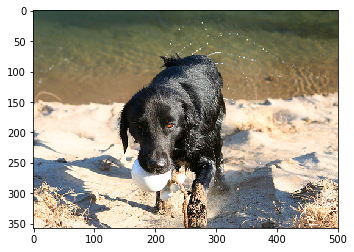

('Normal Max search:', 'A black dog is running in the snow .')
('Beam Search, k=3:', 'A black dog is running in the snow .')
('Beam Search, k=5:', 'A black dog plays in the snow .')
('Beam Search, k=7:', 'A black dog plays in the snow .')


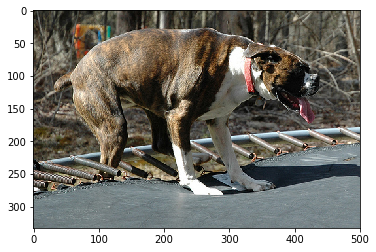

('Normal Max search:', 'A brown and white dog is running on a dirt path .')
('Beam Search, k=3:', 'A brown and white dog is running in the air .')
('Beam Search, k=5:', 'A brown and white dog is playing with a toy .')
('Beam Search, k=7:', 'A brown and white dog is running in the air .')


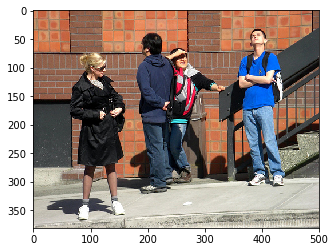

('Normal Max search:', 'A group of men in tuxedos and white uniforms are walking down a street .')
('Beam Search, k=3:', 'A group of young men dressed in black and white and white uniforms are standing on the street .')
('Beam Search, k=5:', 'A group of young men dressed in black and white and white uniforms are standing on the street .')
('Beam Search, k=7:', 'A group of young men stand in front of a building .')


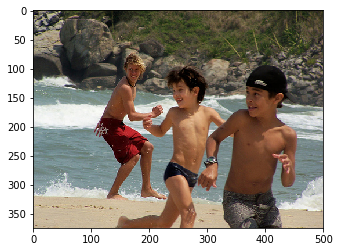

('Normal Max search:', 'Two boys play in the water .')
('Beam Search, k=3:', 'Two young boys play in the water .')
('Beam Search, k=5:', 'Two young boys play in the water .')
('Beam Search, k=7:', 'Two young boys play in the water .')


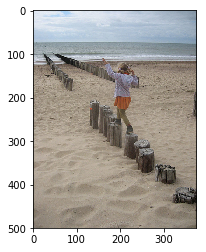

('Normal Max search:', 'Two girls are walking along a beach .')
('Beam Search, k=3:', 'Two young girls are walking along the beach .')
('Beam Search, k=5:', 'Two young girls are walking along the beach .')
('Beam Search, k=7:', 'Two young girls are walking along the beach .')


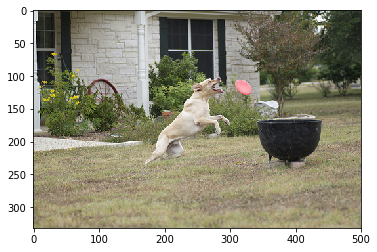

('Normal Max search:', 'A dog is trying to catch a ball in a yard .')
('Beam Search, k=3:', 'A brown dog is trying to catch a tennis ball .')
('Beam Search, k=5:', 'A dog catches a tennis ball .')
('Beam Search, k=7:', 'A dog catches a tennis ball .')


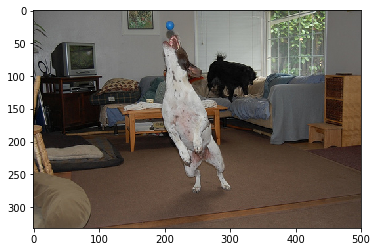

('Normal Max search:', 'A black and white dog is playing in a white carpet .')
('Beam Search, k=3:', 'A black and white and white dog are playing in the kitchen .')
('Beam Search, k=5:', 'A black and white and white and white dog play in front of a white bed .')
('Beam Search, k=7:', 'A black and white and white and white and white and white dog standing in front of a white carpet .')


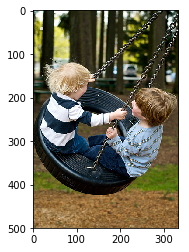

('Normal Max search:', 'A young boy in a blue shirt is swinging on a swing .')
('Beam Search, k=3:', 'A little boy is swinging on a swing .')
('Beam Search, k=5:', 'A little boy is swinging on a swing .')
('Beam Search, k=7:', 'A little boy is swinging on a swing .')


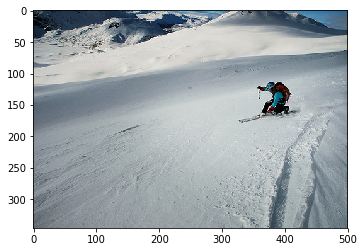

('Normal Max search:', 'A skier skiing down a snowy hill .')
('Beam Search, k=3:', 'A person skiing down a snowy hill .')
('Beam Search, k=5:', 'A man skiing down a snowy hill .')
('Beam Search, k=7:', 'A man skiing down a slope .')


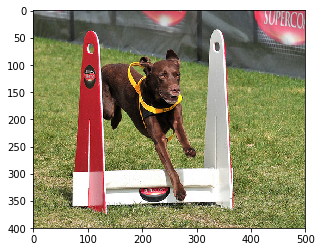

('Normal Max search:', 'A black dog is running through a red tunnel .')
('Beam Search, k=3:', 'A black dog with a red collar .')
('Beam Search, k=5:', 'A black dog with a red collar .')
('Beam Search, k=7:', 'A black dog with a red collar .')


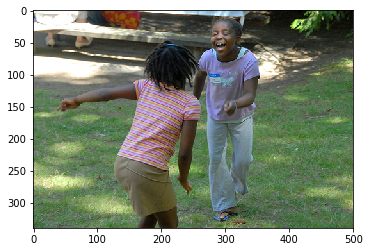

('Normal Max search:', 'A little boy is running on a sidewalk .')
('Beam Search, k=3:', 'A little boy in a red shirt is running on a sidewalk .')
('Beam Search, k=5:', 'A little boy in a red shirt is running through the grass .')
('Beam Search, k=7:', 'A little boy in a pink shirt is running through the grass .')


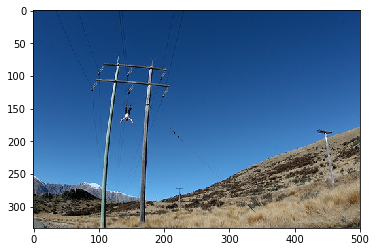

('Normal Max search:', 'A person jumping over a high ramp .')
('Beam Search, k=3:', 'A person jumping over a ramp .')
('Beam Search, k=5:', 'A snowboarder is jumping over a ramp .')
('Beam Search, k=7:', 'A snowboarder is jumping over a ramp .')


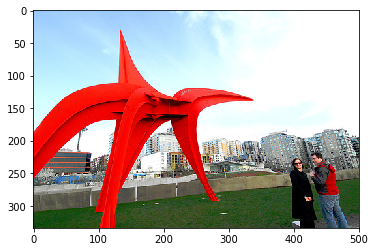

('Normal Max search:', 'A man is sitting on a green slide .')
('Beam Search, k=3:', 'A man in a blue shirt is sitting on a pool .')
('Beam Search, k=5:', 'A man in a blue shirt is sitting on a pool .')
('Beam Search, k=7:', 'A man on a pool .')


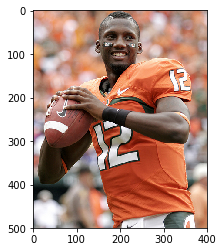

('Normal Max search:', 'A man in a red uniform is running on a game .')
('Beam Search, k=3:', 'A football player in a red uniform is trying to catch the ball .')
('Beam Search, k=5:', 'A football player in blue and white uniform is trying to catch the ball .')
('Beam Search, k=7:', 'A football player in red and white uniform is trying to catch the ball .')


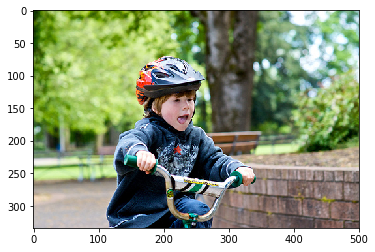

('Normal Max search:', 'A boy in a helmet and a helmet is riding a bicycle .')
('Beam Search, k=3:', 'A boy wearing a helmet is riding a bicycle .')
('Beam Search, k=5:', 'A boy wearing a helmet is riding a bicycle .')
('Beam Search, k=7:', 'A boy wearing a helmet is riding a bicycle .')


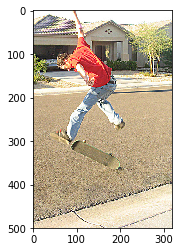

('Normal Max search:', 'A man in a red shirt and a white shirt is rollerblading on a skateboard .')
('Beam Search, k=3:', 'A man in a red shirt and a white shirt .')
('Beam Search, k=5:', 'A man in a red shirt and a white shirt .')
('Beam Search, k=7:', 'A man in a red shirt and a white shirt .')


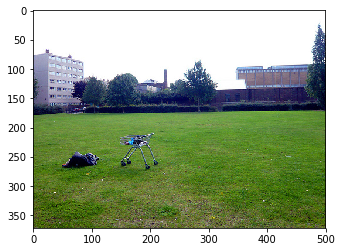

('Normal Max search:', 'A man is riding a bike on a park .')
('Beam Search, k=3:', 'A group of people on a bench .')
('Beam Search, k=5:', 'A group of people sit on a bench .')
('Beam Search, k=7:', 'A man sits on a bench .')


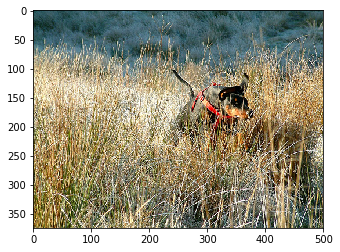

('Normal Max search:', 'A black dog is running through the grass .')
('Beam Search, k=3:', 'A black and brown dog is running through the grass .')
('Beam Search, k=5:', 'A black and brown dog is running through the grass .')
('Beam Search, k=7:', 'A black and brown dog is running through the grass .')


In [51]:
for i in range(450,500):
    try_image = test_img[i]
    im = Image.open(try_image)
    plt.figure()
    plt.imshow(np.asarray(im))
    plt.show()
    print ('Normal Max search:', predict_captions(try_image)) 
    print ('Beam Search, k=3:', beam_search_predictions(try_image, beam_index=3))
    print ('Beam Search, k=5:', beam_search_predictions(try_image, beam_index=5))
    print ('Beam Search, k=7:', beam_search_predictions(try_image, beam_index=7))